In [1]:
from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
import random
import pprint
import sys
import time
import numpy as np
from optparse import OptionParser
import pickle
import math
import cv2
import copy
from matplotlib import pyplot as plt
import tensorflow as tf
import pandas as pd
import configparser
import os
os.environ['TF_XLA_FLAGS'] = '--tf_xla_enable_xla_devices'
from sklearn.metrics import average_precision_score

from keras import backend as K
from keras.optimizers import Adam, SGD, RMSprop
from keras.layers import Flatten, Dense, Input, Conv2D, MaxPooling2D, Dropout
from keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, TimeDistributed
from keras.engine.topology import get_source_inputs
from keras.utils import layer_utils
from keras.utils.data_utils import get_file
from keras.objectives import categorical_crossentropy

from keras.models import Model
from keras.utils import generic_utils
from keras.engine import Layer, InputSpec
from keras import initializers, regularizers

import models.vgg as nn
from models import roi_helpers
from data_generator.data_generators import iou
from tqdm import tqdm

2022-11-22 06:04:42.202818: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1


In [2]:

# load configuration file
config = configparser.ConfigParser()
config.read('training_config.conf')

model_params = {}

# size to resize the smallest side of the image
# Original setting in paper is 600. Set to 416 in here to save training time
model_params['im_size'] = eval(config['model_params']['im_size'])

# image channel-wise mean to subtract
model_params['img_channel_mean'] = eval(config['model_params']['img_channel_mean'])
model_params['img_scaling_factor'] = eval(config['model_params']['img_scaling_factor'])

# stride at the RPN (this depends on the network configuration)
model_params['rpn_stride'] = eval(config['model_params']['rpn_stride'])

# scaling the stdev
# scaling the stdev
model_params['std_scaling'] = eval(config['model_params']['std_scaling'])
model_params['classifier_regr_std'] = eval(config['model_params']['classifier_regr_std'])

# overlaps for RPN
model_params['rpn_min_overlap'] = eval(config['model_params']['rpn_min_overlap'])
model_params['rpn_max_overlap'] = eval(config['model_params']['rpn_max_overlap'])

# overlaps for classifier ROIs
model_params['classifier_min_overlap'] = eval(config['model_params']['classifier_min_overlap'])
model_params['classifier_max_overlap'] = eval(config['model_params']['classifier_max_overlap'])

# Original anchor_box_scales in the paper is [128, 256, 512]
model_params['anchor_box_scales'] = eval(config['model_params']['anchor_box_scales'])

# anchor box ratios
model_params['anchor_box_ratios'] = [[1, 1], [1./math.sqrt(2), 2./math.sqrt(2)], [2./math.sqrt(2), 1./math.sqrt(2)]]

# test image folder
img_path = eval(config['testing']['test_img_path'])

model_path = eval(config['outputs']['model_path'])

num_rois = eval(config['testing']['num_rois'])

class_mapping = pd.read_pickle(eval(config['outputs']['class_mapping']))

class_mapping = {v: k for k, v in class_mapping.items()}
print(class_mapping)
class_to_color = {class_mapping[v]: np.random.randint(0, 255, 3) for v in class_mapping}

{0: 'person', 1: 'chair', 2: 'aeroplane', 3: 'bus', 4: 'car', 5: 'bird', 6: 'pottedplant', 7: 'sofa', 8: 'dog', 9: 'bottle', 10: 'boat', 11: 'motorbike', 12: 'cow', 13: 'diningtable', 14: 'horse', 15: 'bicycle', 16: 'train', 17: 'cat', 18: 'tvmonitor', 19: 'sheep', 20: 'bg'}


In [3]:

def format_img_size(img, C):
	""" formats the image size based on config """
	img_min_side = float(C['im_size'])
	(height,width,_) = img.shape
		
	if width <= height:
		ratio = img_min_side/width
		new_height = int(ratio * height)
		new_width = int(img_min_side)
	else:
		ratio = img_min_side/height
		new_width = int(ratio * width)
		new_height = int(img_min_side)
	img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)
	return img, ratio	

def format_img_channels(img, C):
    """ formats the image channels based on config """
    img = img[:, :, (2, 1, 0)]
    img = img.astype(np.float32)
    img_channel_mean = C['img_channel_mean']
    img[:, :, 0] -= img_channel_mean[0]
    img[:, :, 1] -= img_channel_mean[1]
    img[:, :, 2] -= img_channel_mean[2]
    img /= C['img_scaling_factor']
    img = np.transpose(img, (2, 0, 1))
    img = np.expand_dims(img, axis=0)
    return img

def format_img(img, C):
	""" formats an image for model prediction based on config """
	img, ratio = format_img_size(img, C)
	img = format_img_channels(img, C)
	return img, ratio

# Method to transform the coordinates of the bounding box to its original size
def get_real_coordinates(ratio, x1, y1, x2, y2):

	real_x1 = int(round(x1 // ratio))
	real_y1 = int(round(y1 // ratio))
	real_x2 = int(round(x2 // ratio))
	real_y2 = int(round(y2 // ratio))

	return (real_x1, real_y1, real_x2 ,real_y2)

In [4]:
num_features = 512

input_shape_img = (None, None, 3)
input_shape_features = (None, None, num_features)

img_input = Input(shape=input_shape_img)
roi_input = Input(shape=(num_rois, 4))
feature_map_input = Input(shape=input_shape_features)

# define the base network (resnet here, can be VGG, Inception, etc)
shared_layers = nn.nn_base(img_input, trainable=True)

# define the RPN, built on the base layers
num_anchors = len(model_params['anchor_box_scales']) * len(model_params['anchor_box_ratios'])
rpn_layers = nn.rpn(shared_layers, num_anchors)

classifier = nn.classifier(feature_map_input, roi_input, num_rois, nb_classes=len(class_mapping))

model_rpn = Model(img_input, rpn_layers)
model_classifier_only = Model([feature_map_input, roi_input], classifier)

model_classifier = Model([feature_map_input, roi_input], classifier)

print(f'Loading weights from {model_path}')
model_rpn.load_weights(model_path, by_name=True)
model_classifier.load_weights(model_path, by_name=True)

model_rpn.compile(optimizer='sgd', loss='mse')
model_classifier.compile(optimizer='sgd', loss='mse')

all_imgs = []

classes = {}

visualise = True

# If the box classification value is less than this, we ignore this box
bbox_threshold = 0.1

2022-11-22 06:05:13.489950: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2022-11-22 06:05:14.150441: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-11-22 06:05:14.150713: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2022-11-22 06:05:14.150773: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2022-11-22 06:05:14.153511: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcublas.so.10
2022-11-22 06:05:14.153617: I tensorflow/stream_executor/platform/default/d

Loading weights from models/model_vgg16.hdf5


2007_000032.jpg
Elapsed time = 3.327488899230957
[('aeroplane', 69.20171976089478), ('aeroplane', 68.35637092590332), ('boat', 78.09646725654602)]


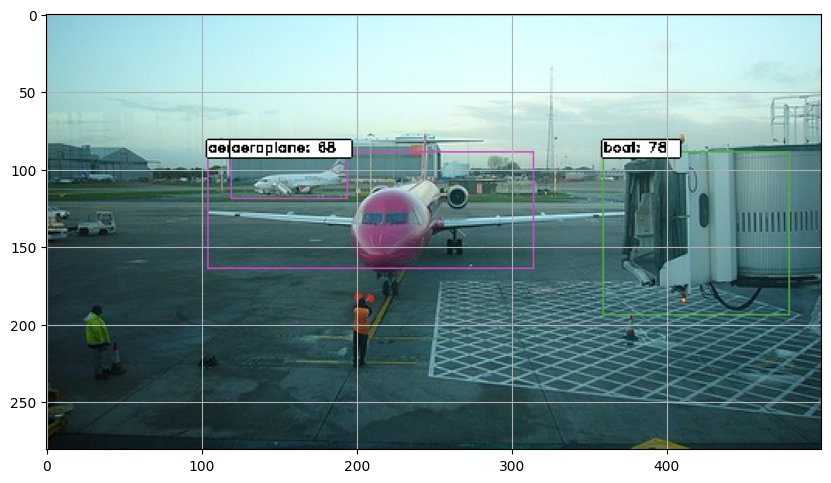

2007_000033.jpg
Elapsed time = 6.734471321105957
[('aeroplane', 98.77774119377136), ('aeroplane', 61.80941462516785), ('tvmonitor', 69.09199953079224), ('boat', 71.46408557891846)]


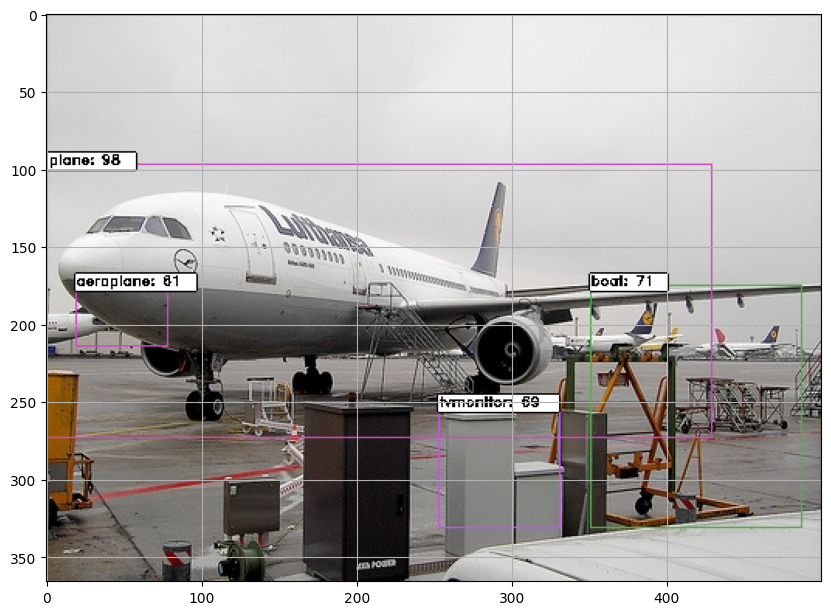

2007_000039.jpg
Elapsed time = 2.9782683849334717
[('tvmonitor', 99.84706044197083)]


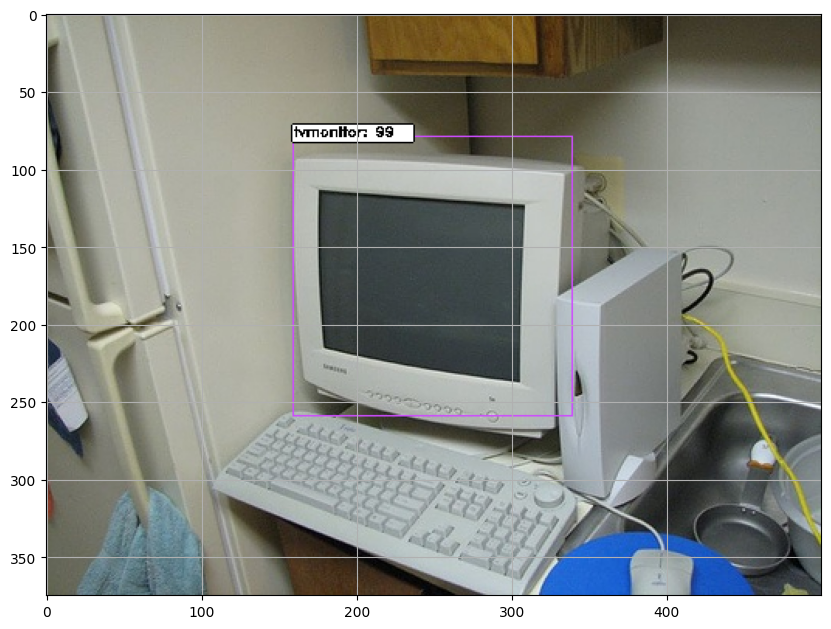

2011_001727.jpg
Elapsed time = 4.2102532386779785
[('dog', 95.91904878616333), ('bottle', 86.57695055007935), ('sofa', 61.10565662384033), ('tvmonitor', 72.08899259567261)]


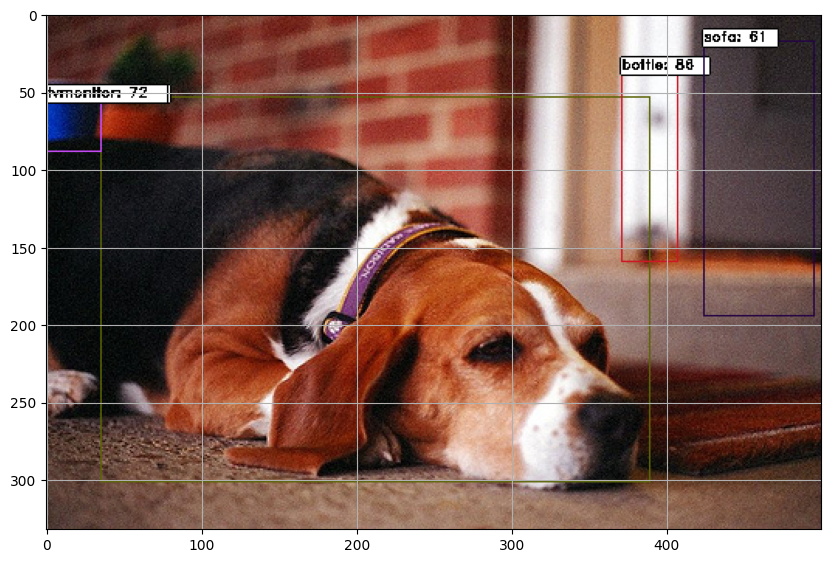

2011_001730.jpg
Elapsed time = 3.0302798748016357
[('tvmonitor', 88.1798505783081), ('tvmonitor', 87.00909614562988), ('tvmonitor', 85.12716889381409), ('tvmonitor', 76.94012522697449), ('tvmonitor', 60.56041121482849)]


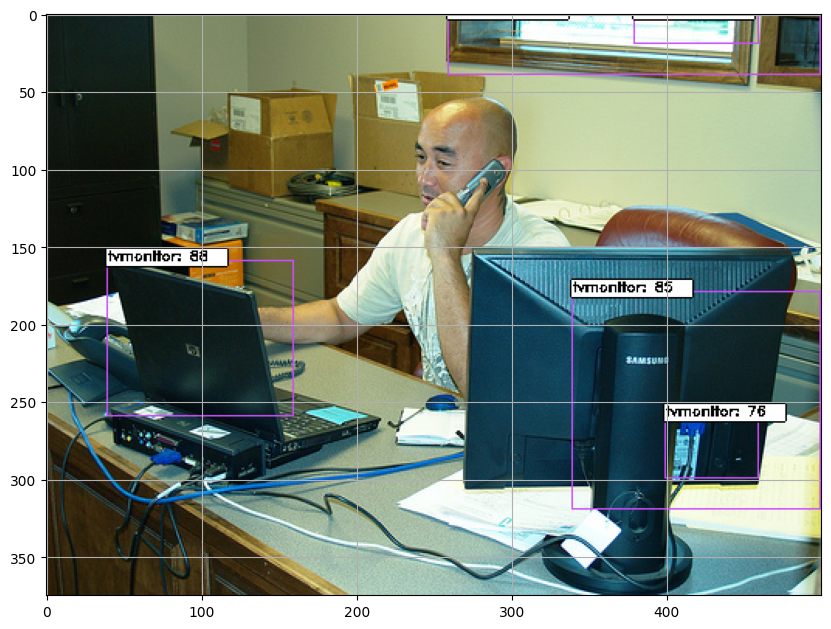

2011_001733.jpg
Elapsed time = 2.8973207473754883
[('cat', 97.61256575584412), ('cat', 85.45502424240112), ('sofa', 92.68497228622437)]


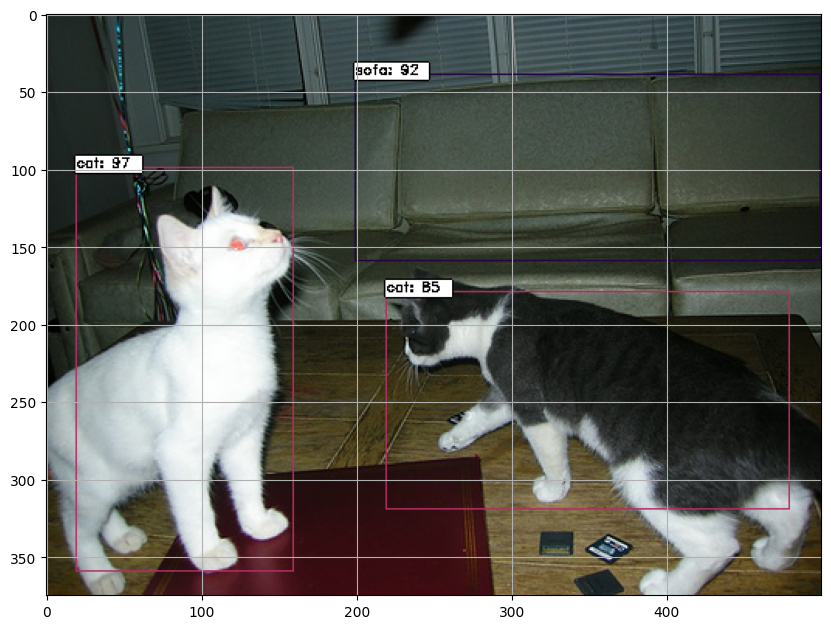

2012_003178.jpg
Elapsed time = 2.8529458045959473
[('person', 96.1816668510437), ('person', 61.5439772605896), ('person', 60.28567552566528), ('pottedplant', 83.09866189956665), ('pottedplant', 68.0418074131012), ('pottedplant', 64.83802795410156), ('chair', 80.92657327651978)]


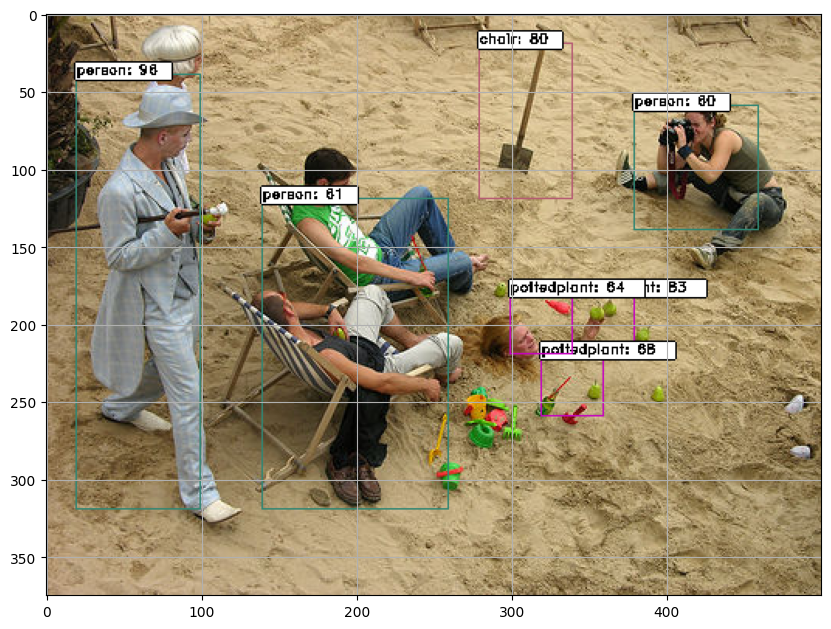

2012_003183.jpg
Elapsed time = 7.918939113616943
[('person', 90.91116786003113), ('person', 84.72139835357666), ('person', 83.3100974559784)]


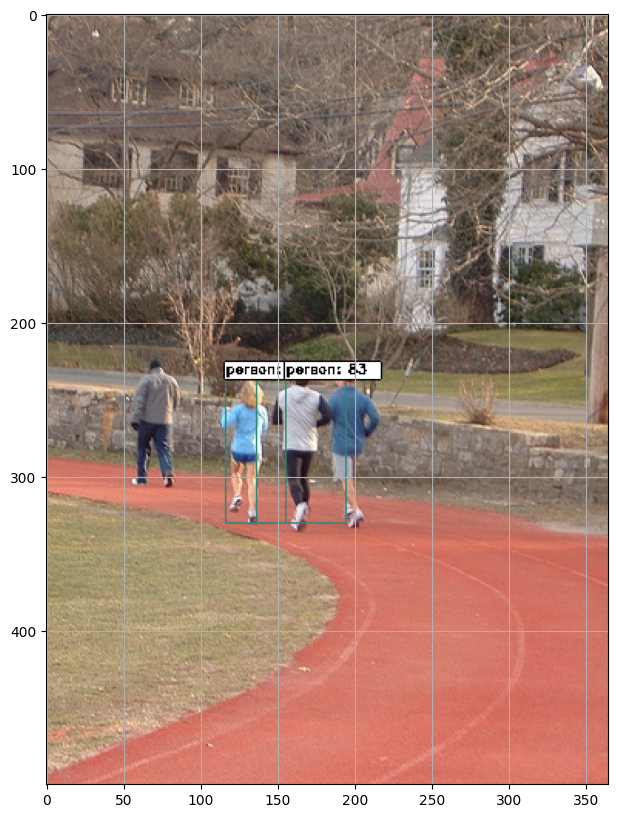

2012_003185.jpg
Elapsed time = 3.03054141998291
[('person', 95.400470495224), ('person', 88.19080591201782)]


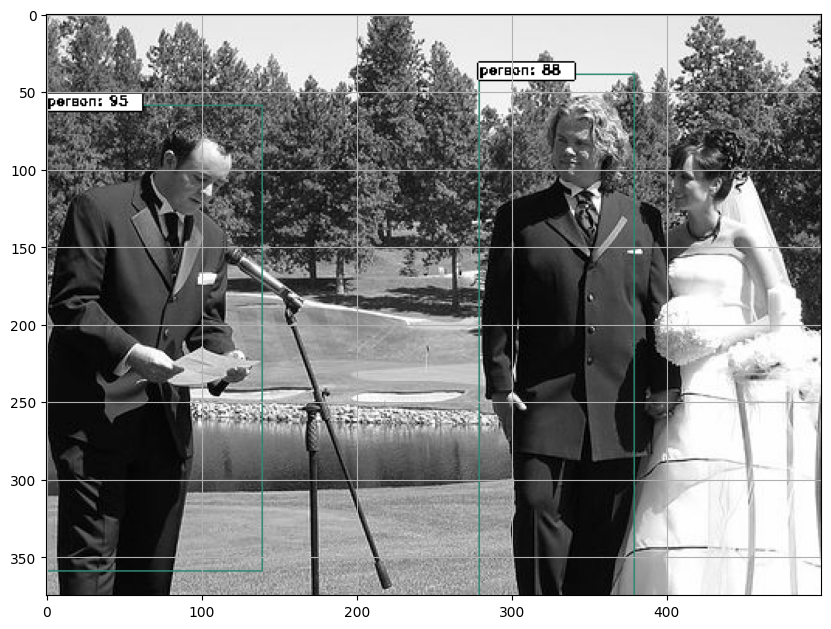

car.jpg
Elapsed time = 2.9533534049987793
[('car', 94.51845288276672), ('car', 86.51955127716064), ('car', 82.00241923332214), ('car', 70.24896144866943), ('tvmonitor', 61.979323625564575)]


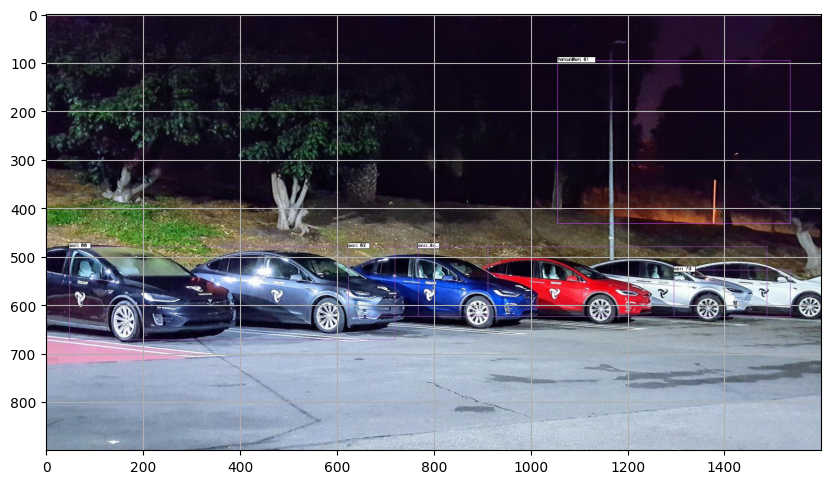

dog.jpg
Elapsed time = 2.9626786708831787
[('bicycle', 96.91768884658813), ('bicycle', 69.51285004615784), ('car', 95.76451778411865), ('cat', 69.86870765686035)]


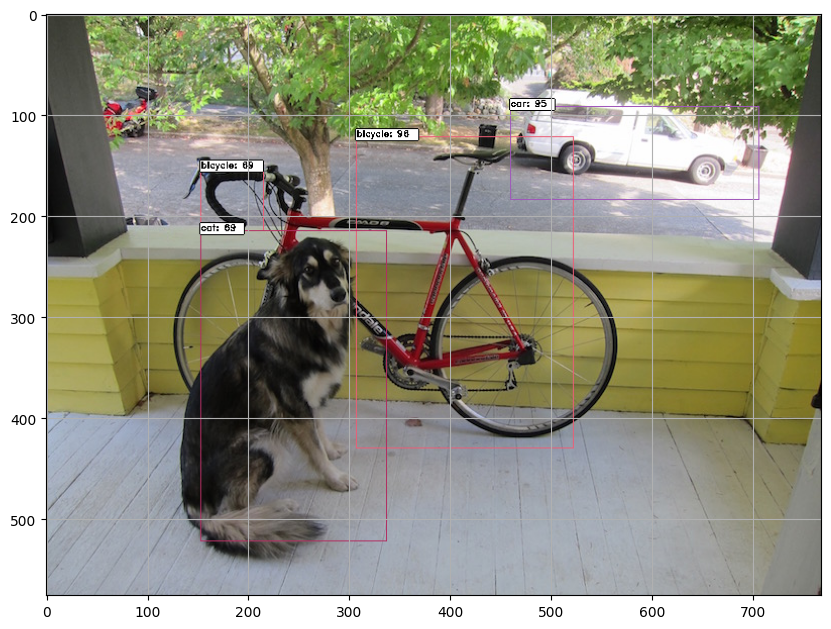

eagle.jpg
Elapsed time = 6.298888921737671
[('bird', 99.82655644416809), ('bird', 64.42131996154785)]


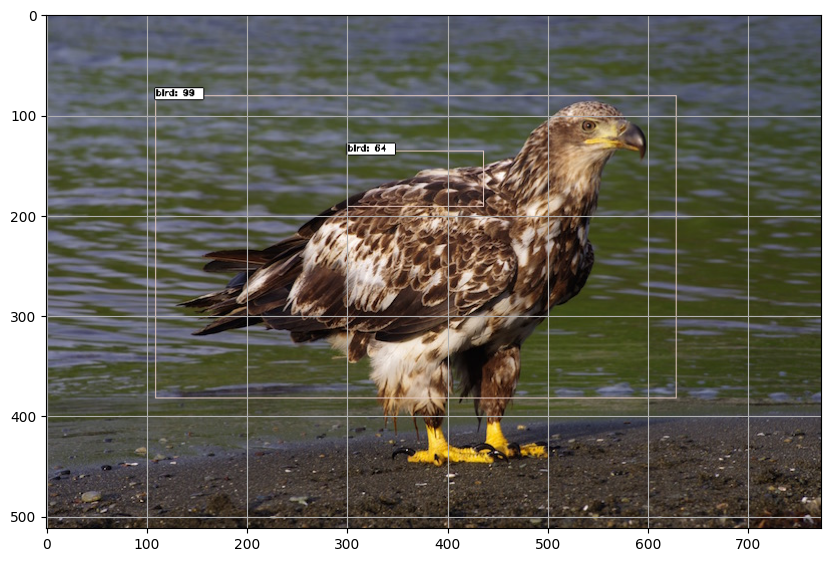

fish_bike.jpg
Elapsed time = 8.292501211166382
[('bicycle', 84.03201103210449), ('bicycle', 82.03809857368469), ('person', 97.01563119888306), ('chair', 66.99017286300659)]


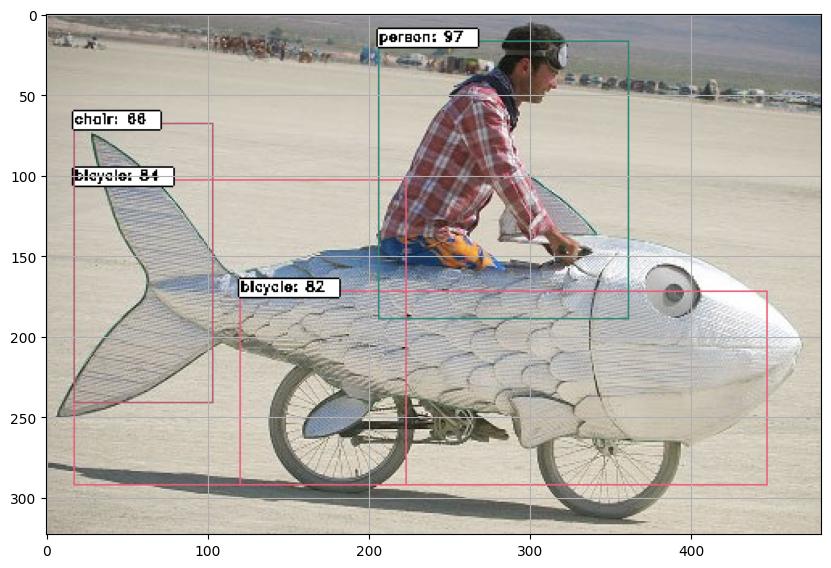

horses.jpg
Elapsed time = 2.8451921939849854
[('horse', 71.45348191261292), ('sheep', 67.29161739349365)]


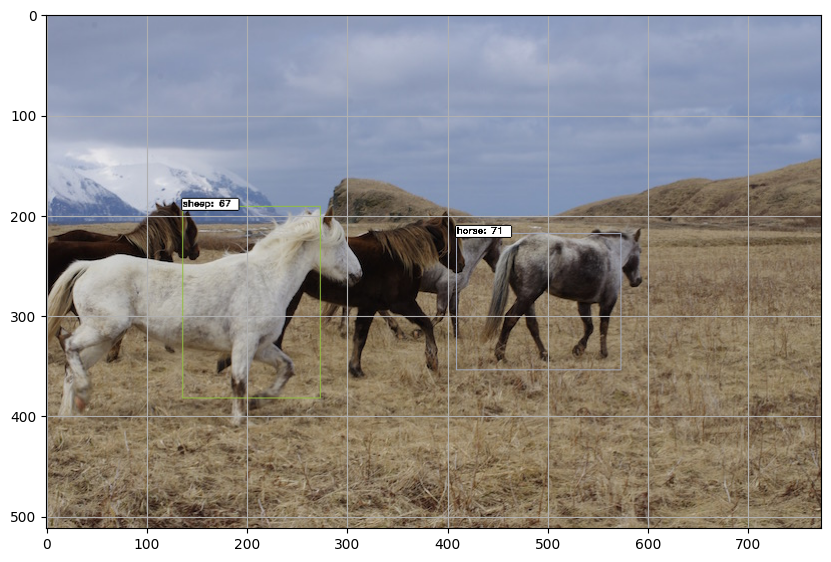

person.jpg
Elapsed time = 2.8404881954193115
[('person', 99.84197616577148), ('sheep', 78.115713596344)]


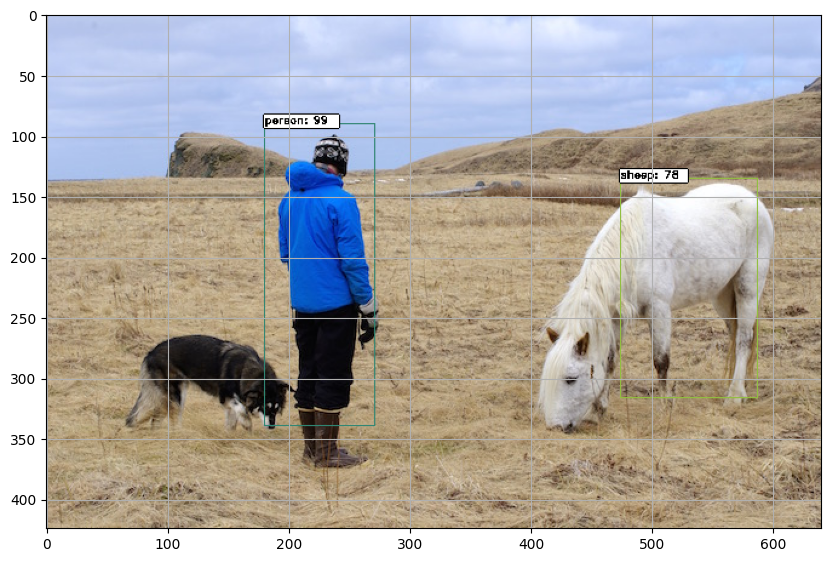

sofa.jpg
Elapsed time = 3.80495285987854
[('pottedplant', 94.49986219406128), ('pottedplant', 89.43893909454346), ('pottedplant', 88.53375911712646), ('pottedplant', 86.9543969631195), ('pottedplant', 70.8533763885498), ('pottedplant', 68.92747282981873), ('pottedplant', 67.99583435058594), ('pottedplant', 64.61610198020935), ('chair', 66.15648865699768)]


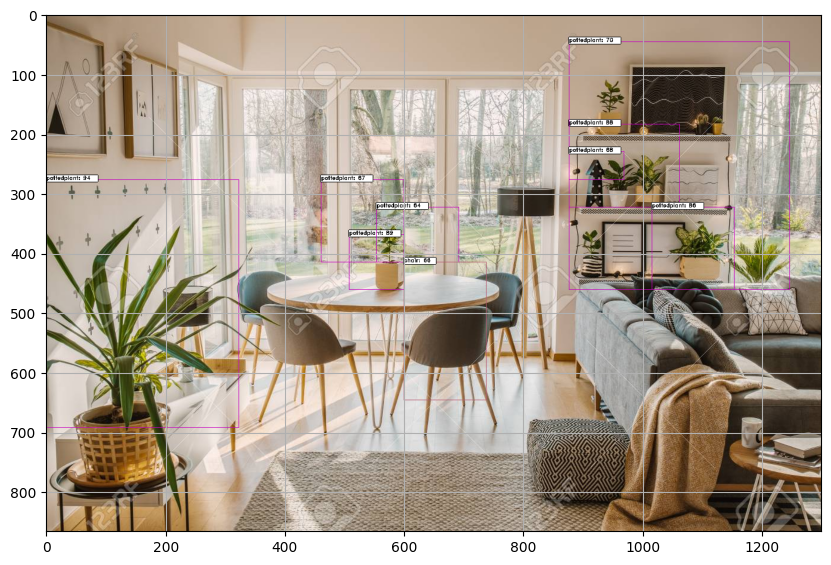

In [39]:
bbox_threshold = 0.6
for idx, img_name in enumerate(sorted(os.listdir(img_path))):
	if not img_name.lower().endswith(('.bmp', '.jpeg', '.jpg', '.png', '.tif', '.tiff')):
		continue
	print(img_name)
	st = time.time()
	filepath = os.path.join(img_path,img_name)

	img = cv2.imread(filepath)

	X, ratio = format_img(img, model_params)

	X = np.transpose(X, (0, 2, 3, 1))

	# get output layer Y1, Y2 from the RPN and the feature maps F
    # Y1: y_rpn_cls
    # Y2: y_rpn_regr
	[Y1, Y2, F] = model_rpn.predict(X)
	
	# Get bboxes by applying NMS 
    # R.shape = (300, 4)
	R = roi_helpers.rpn_to_roi(Y1, Y2, model_params, overlap_thresh=0.7)

	# convert from (x1,y1,x2,y2) to (x,y,w,h)
	R[:, 2] -= R[:, 0]
	R[:, 3] -= R[:, 1]

	#print(R)
	
	# apply the spatial pyramid pooling to the proposed regions
	bboxes = {}
	probs = {}

	for jk in range(R.shape[0]//num_rois + 1):
		ROIs = np.expand_dims(R[num_rois*jk:num_rois*(jk+1), :], axis=0)
		#print(jk, ROIs.shape)
		if ROIs.shape[1] == 0:
			break

		if jk == R.shape[0]//num_rois:
			#pad R
			curr_shape = ROIs.shape
			target_shape = (curr_shape[0],num_rois,curr_shape[2])
			ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
			ROIs_padded[:, :curr_shape[1], :] = ROIs
			ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
			ROIs = ROIs_padded

		[P_cls, P_regr] = model_classifier_only.predict([F, ROIs])
		#print(P_cls.shape, P_regr.shape)
		# Calculate bboxes coordinates on resized image
		for ii in range(P_cls.shape[1]):
			# Ignore 'bg' class
			if np.max(P_cls[0, ii, :]) < bbox_threshold or np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
				continue

			cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

			if cls_name not in bboxes:
				bboxes[cls_name] = []
				probs[cls_name] = []

			(x, y, w, h) = ROIs[0, ii, :]

			cls_num = np.argmax(P_cls[0, ii, :])
			try:
				(tx, ty, tw, th) = P_regr[0, ii, 4*cls_num:4*(cls_num+1)]
				tx /= model_params['classifier_regr_std'][0]
				ty /= model_params['classifier_regr_std'][1]
				tw /= model_params['classifier_regr_std'][2]
				th /= model_params['classifier_regr_std'][3]
				x, y, w, h = roi_helpers.apply_regr(x, y, w, h, tx, ty, tw, th)
			except:
				pass
			bboxes[cls_name].append([model_params['rpn_stride']*x, model_params['rpn_stride']*y, model_params['rpn_stride']*(x+w), model_params['rpn_stride']*(y+h)])
			probs[cls_name].append(np.max(P_cls[0, ii, :]))

	all_dets = []

	for key in bboxes:
		bbox = np.array(bboxes[key])

		new_boxes, new_probs = roi_helpers.non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.2)
		for jk in range(new_boxes.shape[0]):
			(x1, y1, x2, y2) = new_boxes[jk,:]

			(real_x1, real_y1, real_x2, real_y2) = get_real_coordinates(ratio, x1, y1, x2, y2)

			cv2.rectangle(img,(real_x1, real_y1), (real_x2, real_y2), (int(class_to_color[key][0]), int(class_to_color[key][1]), int(class_to_color[key][2])),2)

			textLabel = f'{key}: {int(100*new_probs[jk])}'
			all_dets.append((key,100*new_probs[jk]))

			(retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.3,1)
			textOrg = (real_x1, real_y1-0)

			cv2.rectangle(img, (textOrg[0], textOrg[1]+baseLine), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1]), (0, 0, 0), 2)
			cv2.rectangle(img, (textOrg[0],textOrg[1]+baseLine), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1]), (255, 255, 255), -1)
			cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.3, (0, 0, 0), 1)

	print(f'Elapsed time = {time.time() - st}')
	print(all_dets)
	plt.figure(figsize=(10,10))
	#plt.grid()
	plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
	plt.show()

	cv2.imwrite('{}.png'.format(os.path.splitext(str(img_name))[0]),img)
	#break

In [5]:
def get_map(pred, gt, f):
	T = {}
	P = {}
	fx, fy = f

	for bbox in gt:
		bbox['bbox_matched'] = False

	pred_probs = np.array([s['prob'] for s in pred])
	box_idx_sorted_by_prob = np.argsort(pred_probs)[::-1]

	for box_idx in box_idx_sorted_by_prob:
		pred_box = pred[box_idx]
		pred_class = pred_box['class']
		pred_x1 = pred_box['x1']
		pred_x2 = pred_box['x2']
		pred_y1 = pred_box['y1']
		pred_y2 = pred_box['y2']
		pred_prob = pred_box['prob']
		if pred_class not in P:
			P[pred_class] = []
			T[pred_class] = []
		P[pred_class].append(pred_prob)
		found_match = False

		for gt_box in gt:
			gt_class = gt_box['class']
			gt_x1 = gt_box['x1']/fx
			gt_x2 = gt_box['x2']/fx
			gt_y1 = gt_box['y1']/fy
			gt_y2 = gt_box['y2']/fy
			gt_seen = gt_box['bbox_matched']
			if gt_class != pred_class:
				continue
			if gt_seen:
				continue
			iou_map = iou((pred_x1, pred_y1, pred_x2, pred_y2), (gt_x1, gt_y1, gt_x2, gt_y2))
			if iou_map >= 0.5:
				found_match = True
				gt_box['bbox_matched'] = True
				break
			else:
				continue

		T[pred_class].append(int(found_match))

	for gt_box in gt:
		if not gt_box['bbox_matched']:# and not gt_box['difficult']:
			if gt_box['class'] not in P:
				P[gt_box['class']] = []
				T[gt_box['class']] = []

			T[gt_box['class']].append(1)
			P[gt_box['class']].append(0)

	#import pdb
	#pdb.set_trace()
	return T, P

def format_img_map(img, C):
    """Format image for mAP. Resize original image to C.im_size (300 in here)

    Args:
        img: cv2 image
        C: config

    Returns:
        img: Scaled and normalized image with expanding dimension
        fx: ratio for width scaling
        fy: ratio for height scaling
    """

    img_min_side = float(C['im_size'])
    (height,width,_) = img.shape
    
    if width <= height:
        f = img_min_side/width
        new_height = int(f * height)
        new_width = int(img_min_side)
    else:
        f = img_min_side/height
        new_width = int(f * width)
        new_height = int(img_min_side)
    fx = width/float(new_width)
    fy = height/float(new_height)
    img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_CUBIC)

    # Change image channel from BGR to RGB
    img = img[:, :, (2, 1, 0)]
    img = img.astype(np.float32)
    img[:, :, 0] -= C['img_channel_mean'][0]
    img[:, :, 1] -= C['img_channel_mean'][1]
    img[:, :, 2] -= C['img_channel_mean'][2]
    img /= C['img_scaling_factor']
    # Change img shape from (height, width, channel) to (channel, height, width)
    img = np.transpose(img, (2, 0, 1))
    # Expand one dimension at axis 0
    # img shape becames (1, channel, height, width)
    img = np.expand_dims(img, axis=0)
    return img, fx, fy, f
	

In [6]:
from data_generator.pascal_voc_parser import get_data
test_path = "data/VOC2012"
# This might takes a while to parser the data
test_imgs, _, _ = get_data(test_path)
test_imgs = [s for s in test_imgs if s['imageset'] == 'val']
len(test_imgs)

Parsing annotation files


5585

0it [00:00, ?it/s]

{'x1': 32, 'x2': 400, 'y1': 0, 'y2': 272, 'class': 'person', 'prob': 0.7668272}
{'x1': 64, 'x2': 384, 'y1': 0, 'y2': 144, 'class': 'person', 'prob': 0.6619764}
{'x1': 96, 'x2': 400, 'y1': 96, 'y2': 304, 'class': 'person', 'prob': 0.4741373}
{'x1': 48, 'x2': 256, 'y1': 32, 'y2': 288, 'class': 'person', 'prob': 0.38762426}
{'x1': 192, 'x2': 384, 'y1': 32, 'y2': 288, 'class': 'person', 'prob': 0.2575478}
{'x1': 0, 'x2': 32, 'y1': 112, 'y2': 144, 'class': 'bicycle', 'prob': 0.32527292}
{'x1': 0, 'x2': 32, 'y1': 96, 'y2': 176, 'class': 'bicycle', 'prob': 0.30510285}
{'x1': 16, 'x2': 80, 'y1': 192, 'y2': 272, 'class': 'tvmonitor', 'prob': 0.63939345}
{'x1': 0, 'x2': 96, 'y1': 208, 'y2': 256, 'class': 'tvmonitor', 'prob': 0.4933175}
{'x1': 16, 'x2': 128, 'y1': 208, 'y2': 288, 'class': 'tvmonitor', 'prob': 0.49012265}
{'x1': 16, 'x2': 80, 'y1': 208, 'y2': 240, 'class': 'tvmonitor', 'prob': 0.39983207}
{'x1': 0, 'x2': 16, 'y1': 176, 'y2': 208, 'class': 'diningtable', 'prob': 0.48682025}
{'x1': 

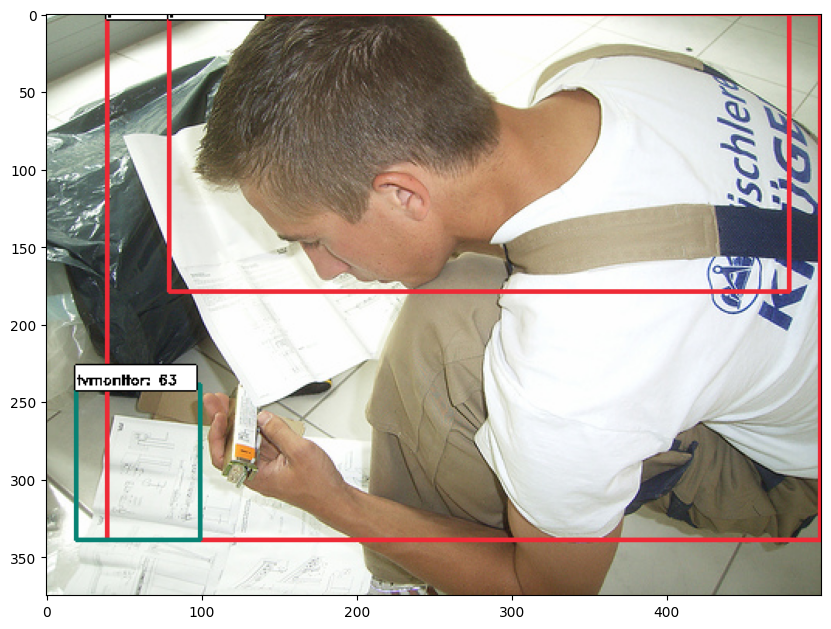

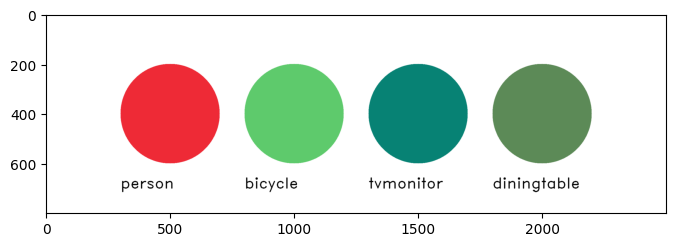

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
1it [00:04,  4.42s/it]

Elapsed time = 4.413616180419922
person AP: 1.0
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
mAP = nan
{'x1': 32, 'x2': 96, 'y1': 112, 'y2': 192, 'class': 'chair', 'prob': 0.5917175}
{'x1': 16, 'x2': 160, 'y1': 96, 'y2': 208, 'class': 'chair', 'prob': 0.53913957}
{'x1': 32, 'x2': 112, 'y1': 64, 'y2': 240, 'class': 'chair', 'prob': 0.5194771}
{'x1': 112, 'x2': 160, 'y1': 16, 'y2': 112, 'class': 'chair', 'prob': 0.4911937}
{'x1': 112, 'x2': 192, 'y1': 32, 'y2': 192, 'class': 'chair', 'prob': 0.4882354}
{'x1': 112, 'x2': 176, 'y1': 64, 'y2': 128, 'class': 'chair', 'prob': 0.4882341}
{'x1': 32, 'x2': 96, 'y1': 16, 'y2': 128, 'class': 'chair', 'prob': 0.48693514}
{'x1': 96, 'x2': 144, 'y1': 32, 'y2': 80, 'class': 'chair', 'prob': 0.48661697}
{'x1': 32, 'x2': 128, 'y1': 16, 'y2': 192, 'class': 'chair', 'prob': 0.486451}
{'x1': 96, 'x2': 144, 'y1': 16, 'y2': 112, 'class': 'chair', 'prob': 0.47550738}
{'x1': 16, 'x2': 192, 'y1': 16, 'y2': 208, 'class': 'chair', 'prob': 0.47091782}
{'x

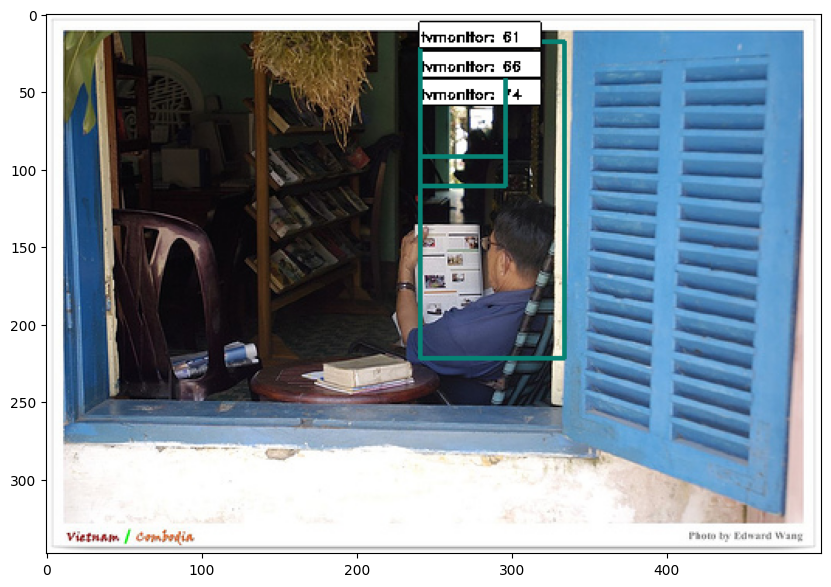

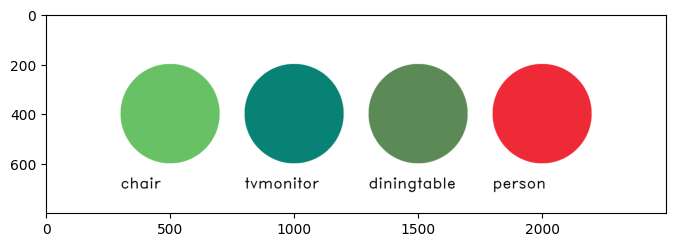

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
2it [00:13,  7.44s/it]

Elapsed time = 9.554952144622803
person AP: 0.6
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
mAP = nan
{'x1': 224, 'x2': 304, 'y1': 128, 'y2': 256, 'class': 'horse', 'prob': 0.9795817}
{'x1': 256, 'x2': 320, 'y1': 128, 'y2': 256, 'class': 'horse', 'prob': 0.96087104}
{'x1': 160, 'x2': 336, 'y1': 112, 'y2': 272, 'class': 'horse', 'prob': 0.9366328}
{'x1': 144, 'x2': 224, 'y1': 128, 'y2': 256, 'class': 'horse', 'prob': 0.91095346}
{'x1': 128, 'x2': 192, 'y1': 128, 'y2': 256, 'class': 'horse', 'prob': 0.85371727}
{'x1': 32, 'x2': 320, 'y1': 128, 'y2': 272, 'class': 'horse', 'prob': 0.8532306}
{'x1': 208, 'x2': 384, 'y1': 128, 'y2': 256, 'class': 'horse', 'prob': 0.72169644}
{'x1': 224, 'x2': 288, 'y1': 112, 'y2': 208, 'class': 'horse', 'prob': 0.6127188}
{'x1': 240, 'x2': 304, 'y1': 144, 'y2': 208, 'class': 'horse', 'prob': 0.5493048}
{'x1': 224, 'x2': 272, 'y1': 128, 'y2': 160, 'class': 'horse', 'prob': 0.40687856}
{'x1': 384, 'x2': 448, 'y1': 128, 'y2': 192, 'clas

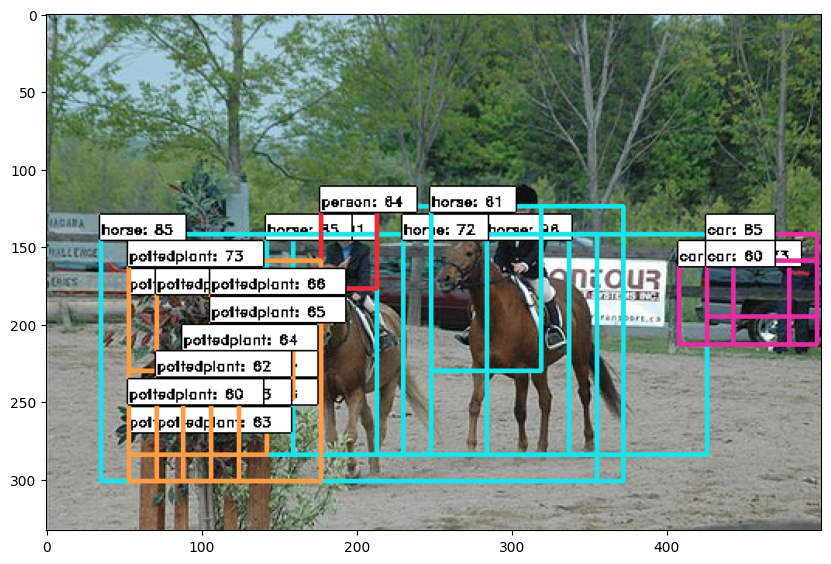

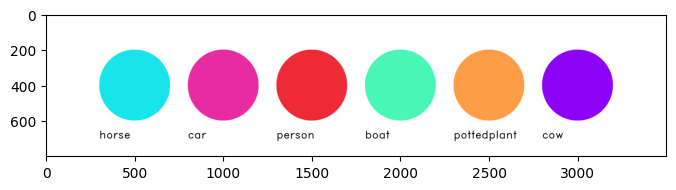

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 8.059439182281494
person AP: 0.4043831168831169
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
mAP = nan
{'x1': 32, 'x2': 160, 'y1': 160, 'y2': 240, 'class': 'horse', 'prob': 0.6232791}
{'x1': 64, 'x2': 112, 'y1': 144, 'y2': 240, 'class': 'horse', 'prob': 0.47282758}
{'x1': 48, 'x2': 128, 'y1': 160, 'y2': 224, 'class': 'horse', 'prob': 0.42649567}
{'x1': 48, 'x2': 80, 'y1': 144, 'y2': 224, 'class': 'horse', 'prob': 0.38061264}
{'x1': 128, 'x2': 160, 'y1': 160, 'y2': 240, 'class': 'horse', 'prob': 0.37542218}
{'x1': 64, 'x2': 144, 'y1': 176, 'y2': 240, 'class': 'horse', 'prob': 0.3042306}
{'x1': 32, 'x2': 64, 'y1': 160, 'y2': 224, 'class': 'person', 'prob': 0.5819379}
{'x1': 16, 'x2': 48, 'y1': 160, 'y2': 224, 'class': 'person', 'prob': 0.43373686}
{'x1': 32, 'x2': 80, 'y1': 144, 'y2': 208, 'class': 'person', 'prob': 0.4156751}
{'x1': 272, 'x2': 320, 'y1': 160, 'y2': 224, 'class': 

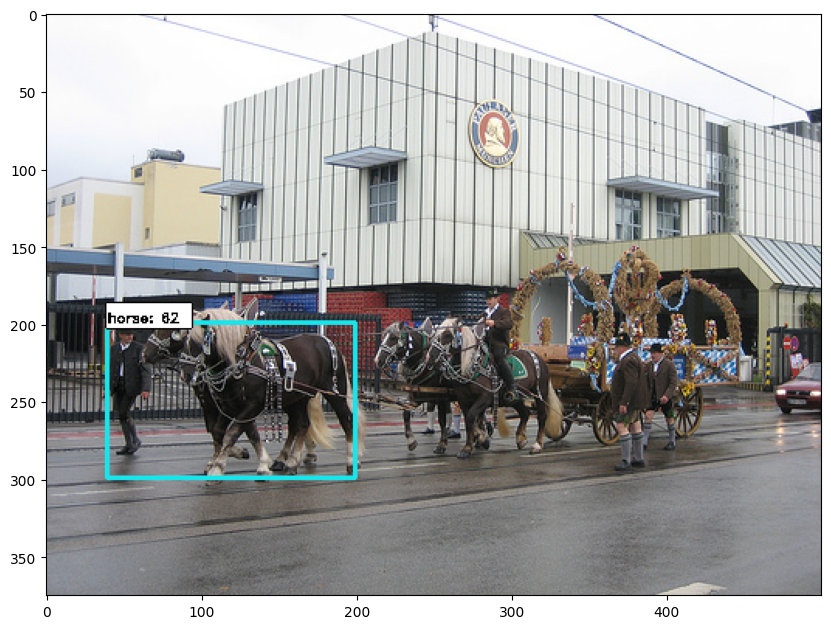

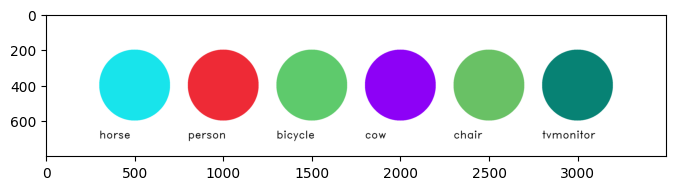

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 3.7613401412963867
person AP: 0.35122576698663655
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
mAP = nan
{'x1': 208, 'x2': 320, 'y1': 80, 'y2': 288, 'class': 'person', 'prob': 0.9079432}
{'x1': 16, 'x2': 320, 'y1': 80, 'y2': 304, 'class': 'person', 'prob': 0.8582787}
{'x1': 48, 'x2': 176, 'y1': 96, 'y2': 288, 'class': 'person', 'prob': 0.70880795}
{'x1': 48, 'x2': 256, 'y1': 144, 'y2': 272, 'class': 'person', 'prob': 0.5148785}
{'x1': 288, 'x2': 320, 'y1': 96, 'y2': 192, 'class': 'person', 'prob': 0.40756097}
{'x1': 288, 'x2': 304, 'y1': 176, 'y2': 192, 'class': 'person', 'prob': 0.3205994}
{'x1': 288, 'x2': 320, 'y1': 160, 'y2': 192, 'class': 'person', 'prob': 0.28172135}
{'x1': 304, 'x2': 320, 'y1': 160, 'y2': 176, 'class': 'person', 'prob': 0.2771583}
{'x1': 112, 'x2': 224, 'y1': 96, 'y2': 288, 'class': 'person', 'prob': 0.26212755}
{'x1': 304, 'x2': 320, 'y1': 176, 'y2': 192

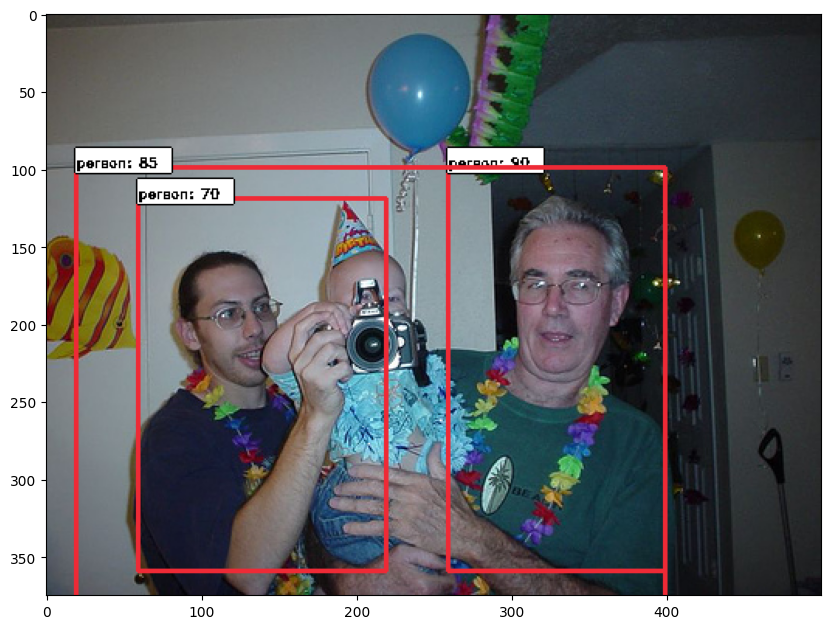

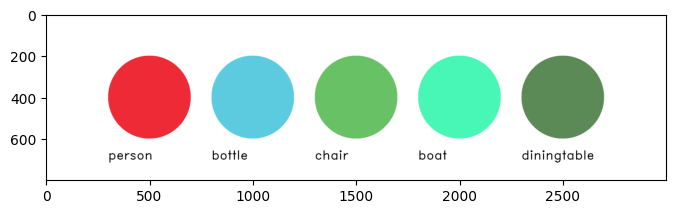

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 3.592519521713257
person AP: 0.1881246657644173
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: nan
mAP = nan
{'x1': 128, 'x2': 256, 'y1': 80, 'y2': 176, 'class': 'person', 'prob': 0.8362816}
{'x1': 48, 'x2': 144, 'y1': 96, 'y2': 304, 'class': 'person', 'prob': 0.8041867}
{'x1': 32, 'x2': 208, 'y1': 64, 'y2': 320, 'class': 'person', 'prob': 0.7918801}
{'x1': 160, 'x2': 224, 'y1': 80, 'y2': 160, 'class': 'person', 'prob': 0.7115926}
{'x1': 0, 'x2': 176, 'y1': 160, 'y2': 272, 'class': 'person', 'prob': 0.60999745}
{'x1': 0, 'x2': 160, 'y1': 112, 'y2': 336, 'class': 'person', 'prob': 0.6065544}
{'x1': 160, 'x2': 272, 'y1': 96, 'y2': 144, 'class': 'person', 'prob': 0.5405874}
{'x1': 128, 'x2': 224, 'y1': 64, 'y2': 224, 'class': 'person', 'prob': 0.5204805}
{'x1': 144, 'x2': 208, 'y1': 80, 'y2': 128, 'class': 'person', 'prob': 0.5052915}
{'x1': 112, 'x2': 272, 'y1': 112, 'y2'

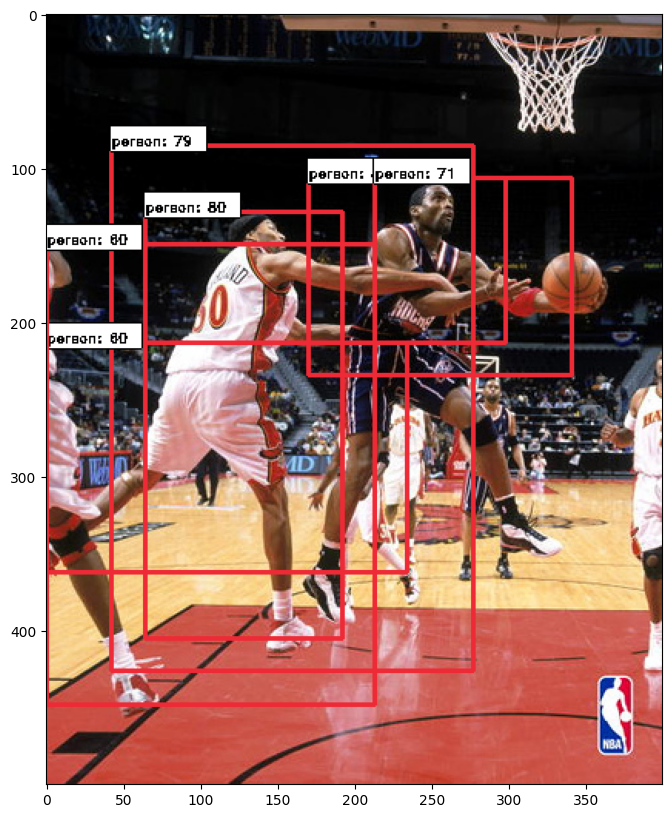

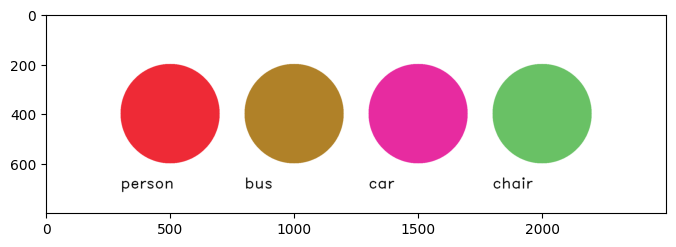

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 8.72773003578186
person AP: 0.11948829356917592
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: nan
bus AP: nan
mAP = nan
{'x1': 64, 'x2': 192, 'y1': 128, 'y2': 320, 'class': 'person', 'prob': 0.9152833}
{'x1': 112, 'x2': 208, 'y1': 112, 'y2': 304, 'class': 'person', 'prob': 0.6659283}
{'x1': 32, 'x2': 288, 'y1': 96, 'y2': 304, 'class': 'person', 'prob': 0.6487149}
{'x1': 192, 'x2': 368, 'y1': 112, 'y2': 192, 'class': 'tvmonitor', 'prob': 0.5303612}
{'x1': 208, 'x2': 400, 'y1': 160, 'y2': 272, 'class': 'sofa', 'prob': 0.4840645}
{'x1': 224, 'x2': 320, 'y1': 160, 'y2': 288, 'class': 'sofa', 'prob': 0.4265591}


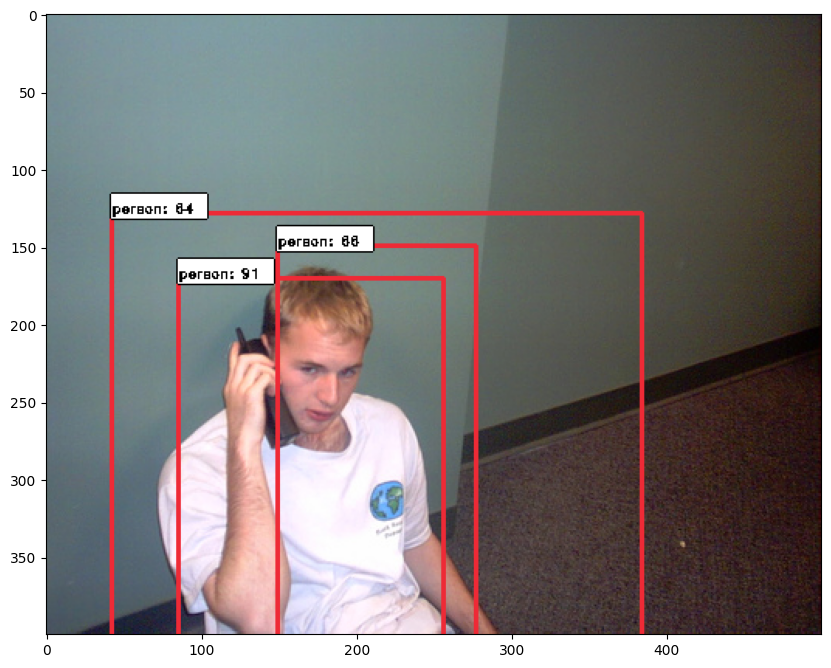

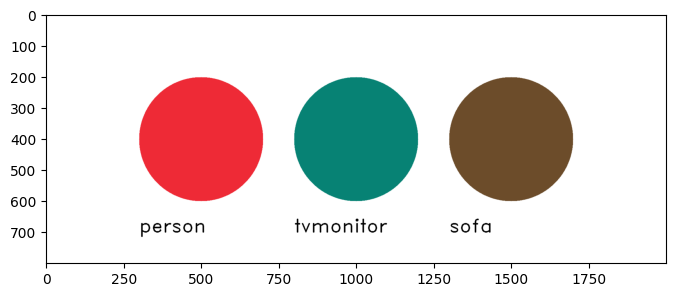

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 7.858046054840088
person AP: 0.24313277821676477
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: nan
bus AP: nan
sofa AP: nan
mAP = nan
{'x1': 80, 'x2': 272, 'y1': 16, 'y2': 288, 'class': 'person', 'prob': 0.6789701}
{'x1': 160, 'x2': 288, 'y1': 48, 'y2': 192, 'class': 'person', 'prob': 0.6606195}
{'x1': 144, 'x2': 240, 'y1': 32, 'y2': 256, 'class': 'person', 'prob': 0.46929306}
{'x1': 64, 'x2': 368, 'y1': 32, 'y2': 224, 'class': 'person', 'prob': 0.46772867}
{'x1': 112, 'x2': 208, 'y1': 48, 'y2': 272, 'class': 'person', 'prob': 0.46563417}
{'x1': 0, 'x2': 80, 'y1': 80, 'y2': 272, 'class': 'person', 'prob': 0.44392923}
{'x1': 48, 'x2': 80, 'y1': 128, 'y2': 240, 'class': 'person', 'prob': 0.36628342}
{'x1': 240, 'x2': 272, 'y1': 80, 'y2': 160, 'class': 'person', 'prob': 0.21140479}
{'x1': 320, 'x2': 384, 'y1': 160, 'y2': 288, 'class': 'diningtable', 'prob': 0.77377933}
{'

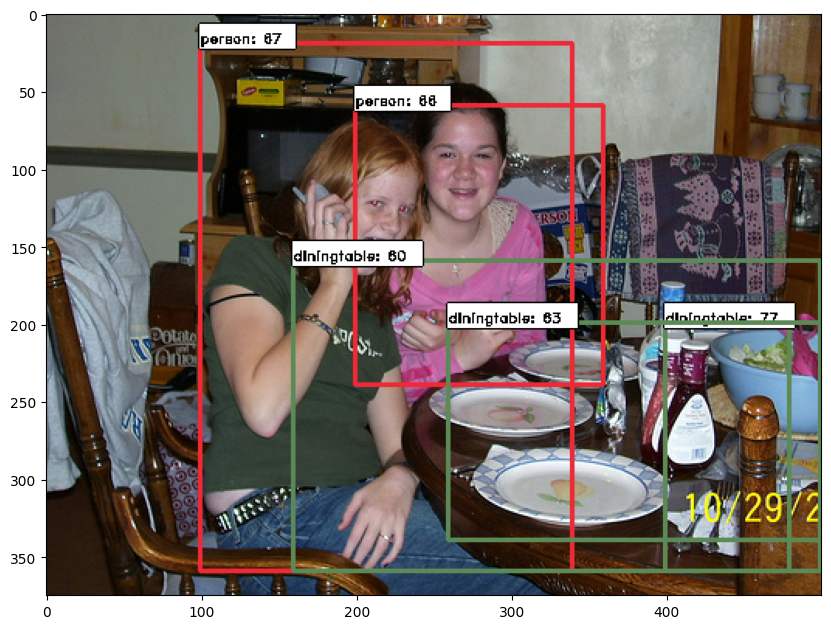

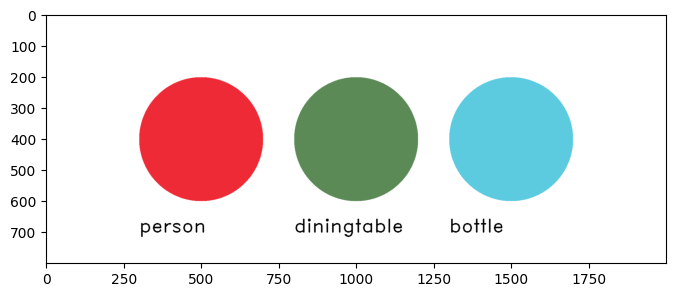

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 3.4260010719299316
person AP: 0.27635714527422683
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: nan
bus AP: nan
sofa AP: nan
mAP = nan
{'x1': 192, 'x2': 240, 'y1': 144, 'y2': 256, 'class': 'person', 'prob': 0.9453237}
{'x1': 96, 'x2': 160, 'y1': 192, 'y2': 384, 'class': 'person', 'prob': 0.8739625}
{'x1': 208, 'x2': 240, 'y1': 176, 'y2': 272, 'class': 'person', 'prob': 0.65260714}
{'x1': 192, 'x2': 240, 'y1': 160, 'y2': 192, 'class': 'person', 'prob': 0.39746875}
{'x1': 96, 'x2': 176, 'y1': 192, 'y2': 384, 'class': 'horse', 'prob': 0.46143562}
{'x1': 96, 'x2': 144, 'y1': 208, 'y2': 320, 'class': 'horse', 'prob': 0.38859972}
{'x1': 0, 'x2': 32, 'y1': 64, 'y2': 144, 'class': 'horse', 'prob': 0.30715787}
{'x1': 48, 'x2': 112, 'y1': 0, 'y2': 176, 'class': 'boat', 'prob': 0.37650847}
{'x1': 128, 'x2': 160, 'y1': 96, 'y2': 144, 'class': 'boat', 'prob': 0.32639965}
{'x1': 64,

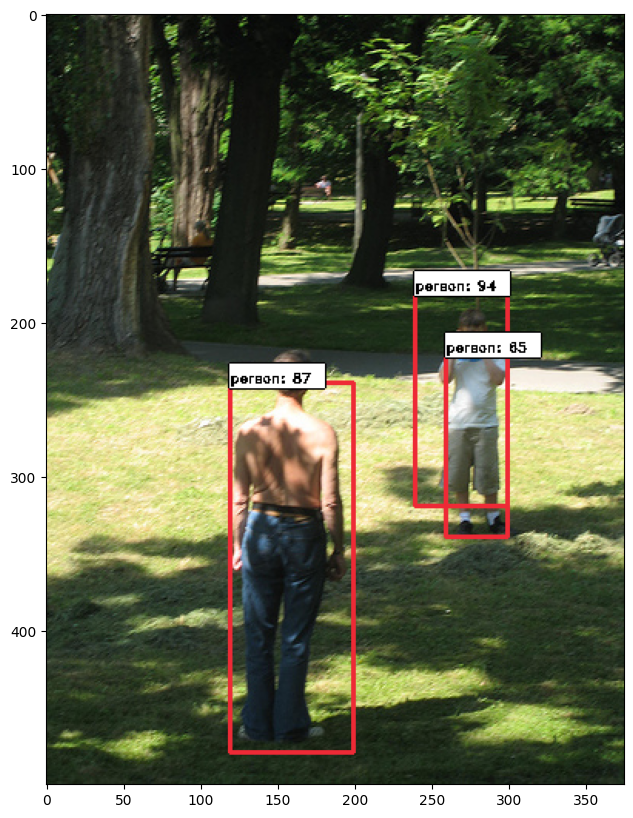

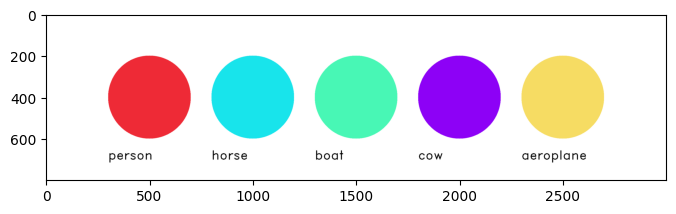

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 8.391708850860596
person AP: 0.3500863793089655
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: nan
bus AP: nan
sofa AP: nan
aeroplane AP: nan
mAP = nan
{'x1': 0, 'x2': 240, 'y1': 64, 'y2': 320, 'class': 'person', 'prob': 0.90565425}
{'x1': 0, 'x2': 272, 'y1': 160, 'y2': 432, 'class': 'person', 'prob': 0.7996607}
{'x1': 192, 'x2': 272, 'y1': 368, 'y2': 416, 'class': 'bottle', 'prob': 0.285194}
{'x1': 208, 'x2': 256, 'y1': 352, 'y2': 432, 'class': 'bottle', 'prob': 0.28251997}


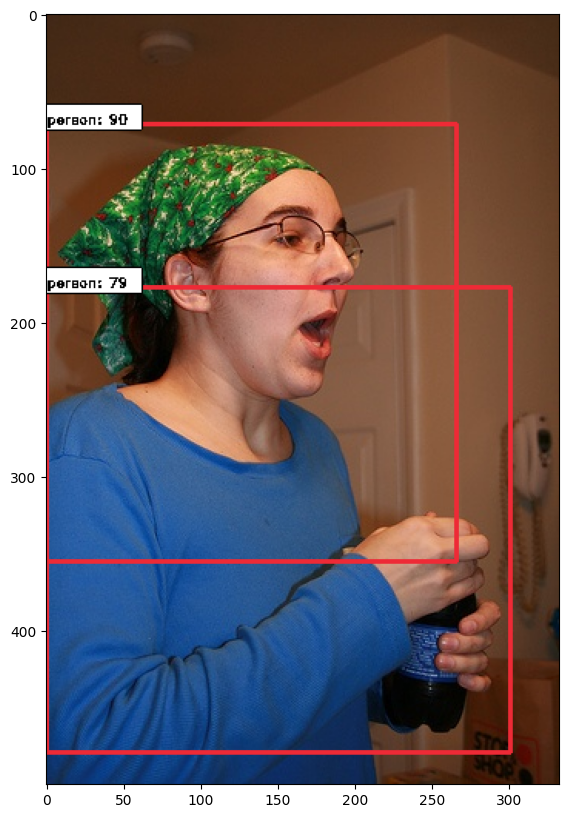

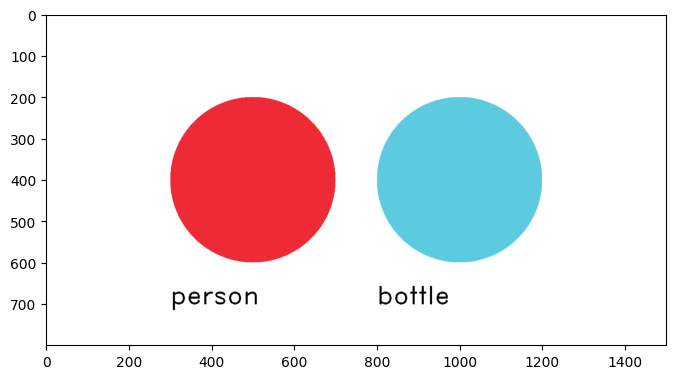

/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid value encountered in true_divide
  recall = tps / tps[-1]
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/sklearn/metrics/_ranking.py:864: RuntimeWarning: invalid val

Elapsed time = 8.423011779785156
person AP: 0.3929578669030488
tvmonitor AP: nan
diningtable AP: nan
bicycle AP: nan
chair AP: nan
horse AP: nan
car AP: nan
pottedplant AP: nan
boat AP: nan
cow AP: nan
bottle AP: 0.05555555555555555
bus AP: nan
sofa AP: nan
aeroplane AP: nan
mAP = nan
mean average precision: nan


In [18]:
bbox_threshold = 0.6
T = {}
P = {}
mAPs = []
for idx, img_data in tqdm(enumerate(test_imgs[:10])):
    #print('{}/{}'.format(idx,len(test_imgs)))
    st = time.time()
    filepath = img_data['filepath']
    #print(filepath)

    img = cv2.imread(filepath)

    X, fx, fy, ratio = format_img_map(img, model_params)

    # Change X (img) shape from (1, channel, height, width) to (1, height, width, channel)
    X = np.transpose(X, (0, 2, 3, 1))

    # get the feature maps and output from the RPN
    [Y1, Y2, F] = model_rpn.predict(X)


    R = roi_helpers.rpn_to_roi(Y1, Y2, model_params, overlap_thresh=0.7)

    # convert from (x1,y1,x2,y2) to (x,y,w,h)
    R[:, 2] -= R[:, 0]
    R[:, 3] -= R[:, 1]

    # apply the spatial pyramid pooling to the proposed regions
    bboxes = {}
    probs = {}

    for jk in range(R.shape[0] // num_rois + 1):
        ROIs = np.expand_dims(R[num_rois * jk:num_rois * (jk + 1), :], axis=0)
        if ROIs.shape[1] == 0:
            break

        if jk == R.shape[0] // num_rois:
            # pad R
            curr_shape = ROIs.shape
            target_shape = (curr_shape[0], num_rois, curr_shape[2])
            ROIs_padded = np.zeros(target_shape).astype(ROIs.dtype)
            ROIs_padded[:, :curr_shape[1], :] = ROIs
            ROIs_padded[0, curr_shape[1]:, :] = ROIs[0, 0, :]
            ROIs = ROIs_padded

        [P_cls, P_regr] = model_classifier_only.predict([F, ROIs])

        # Calculate all classes' bboxes coordinates on resized image (300, 400)
        # Drop 'bg' classes bboxes
        for ii in range(P_cls.shape[1]):

            # If class name is 'bg', continue
            if np.argmax(P_cls[0, ii, :]) == (P_cls.shape[2] - 1):
                continue

            # Get class name
            cls_name = class_mapping[np.argmax(P_cls[0, ii, :])]

            if cls_name not in bboxes:
                bboxes[cls_name] = []
                probs[cls_name] = []

            (x, y, w, h) = ROIs[0, ii, :]

            cls_num = np.argmax(P_cls[0, ii, :])
            try:
                (tx, ty, tw, th) = P_regr[0, ii, 4 * cls_num:4 * (cls_num + 1)]
                tx /= model_params['classifier_regr_std'][0]
                ty /= model_params['classifier_regr_std'][1]
                tw /= model_params['classifier_regr_std'][2]
                th /= model_params['classifier_regr_std'][3]
                x, y, w, h = roi_helpers.apply_regr(x, y, w, h, tx, ty, tw, th)
            except:
                pass
            bboxes[cls_name].append([16 * x, 16 * y, 16 * (x + w), 16 * (y + h)])
            probs[cls_name].append(np.max(P_cls[0, ii, :]))

    all_dets = []

    for key in bboxes:
        bbox = np.array(bboxes[key])
        # Apply non-max-suppression on final bboxes to get the output bounding boxe
        new_boxes, new_probs = roi_helpers.non_max_suppression_fast(bbox, np.array(probs[key]), overlap_thresh=0.5)
        for jk in range(new_boxes.shape[0]):
            (x1, y1, x2, y2) = new_boxes[jk, :]

            det = {'x1': x1, 'x2': x2, 'y1': y1, 'y2': y2, 'class': key, 'prob': new_probs[jk]}
            print(det)
            all_dets.append(det)
            if new_probs[jk]>bbox_threshold:
            
                (real_x1, real_y1, real_x2, real_y2) = get_real_coordinates(ratio, x1, y1, x2, y2)

                cv2.rectangle(img, (real_x1, real_y1), (real_x2, real_y2), (int(class_to_color[key][0]), int(class_to_color[key][1]), int(class_to_color[key][2])), 2)

                textLabel = f'{key}: {int(100*new_probs[jk])}'

                (retval,baseLine) = cv2.getTextSize(textLabel,cv2.FONT_HERSHEY_COMPLEX,0.3,1)
                textOrg = (real_x1, real_y1-0)

                #cv2.rectangle(img, (textOrg[0], textOrg[1]+baseLine), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (0, 0, 0), 2)
                #cv2.rectangle(img, (textOrg[0],textOrg[1]+baseLine), (textOrg[0]+retval[0] + 5, textOrg[1]-retval[1] - 5), (255, 255, 255), -1)
                #cv2.putText(img, textLabel, textOrg, cv2.FONT_HERSHEY_DUPLEX, 0.3, (0, 0, 0), 1)

    plt.figure(figsize=(10,10))
    #plt.grid()
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    plt.show()

    
    # Initialize blank mask image of same dimensions for drawing the shapes
    shapes = np.ones((800, 500*(len(bboxes)+1), 3), np.uint8)*255
    for i, key in enumerate(bboxes):
        cv2.circle(shapes, (500*(i+1), 400), 200, (int(class_to_color[key][0]), int(class_to_color[key][1]), int(class_to_color[key][2])), cv2.FILLED)
        cv2.putText(shapes, key, (500*(i+1)-200, 700), cv2.FONT_HERSHEY_DUPLEX, 2, (0, 0, 0), 2)
    plt.figure(figsize=(8, 8*len(bboxes)))
    plt.imshow(cv2.cvtColor(shapes, cv2.COLOR_BGR2RGB))
    plt.show()


    print('Elapsed time = {}'.format(time.time() - st))
    t, p = get_map(all_dets, img_data['bboxes'], (fx, fy))
    for key in t.keys():
        if key not in T:
            T[key] = []
            P[key] = []
        T[key].extend(t[key])
        P[key].extend(p[key])
    all_aps = []
    for key in T.keys():
        ap = average_precision_score(T[key], P[key])
        print('{} AP: {}'.format(key, ap))
        all_aps.append(ap)
    print('mAP = {}'.format(np.mean(np.array(all_aps))))
    mAPs.append(np.mean(np.array(all_aps)))
    #print(T)
    #print(P)
    
print('mean average precision:', np.mean(np.array(mAPs)))
#cv2.imwrite('{}.png'.format(os.path.splitext(str(img_name))[0]),img)
	

In [19]:
mAP = [mAP for mAP in mAPs if str(mAP)!='nan']
mean_average_prec = round(np.mean(np.array(mAP)), 3)
print('the mean average precision is %0.3f'%(mean_average_prec))

the mean average precision is nan


/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/abhinav_jhanwar_valuelabs_com/anaconda3/envs/object_detection/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
